In [1]:
import warnings
warnings.filterwarnings("ignore")


In [2]:
## for data
import numpy as np
import pandas as pd
## for plotting
import matplotlib.pyplot as plt
import seaborn as sns
## for geospatial
import folium
import geopy
## for machine learning
from sklearn import preprocessing, cluster
import scipy
## for deep learning
import minisom

In [3]:
dtf = pd.read_csv('ToDo.csv')

In [4]:
dtf.head()

,collection_sno,benid,stage,creationtime,status,app,observer_name,deviceid,lat,long
0,4775416,031514123NG623820,Below Basement Level (BBL),12/8/2016 11:59,1,1.7,G APPALANAIDU,AE034101,17.504740,82.943947
1,4775415,031514121NG623871,Lintel Level (LL),12/8/2016 12:09,1,1.7,G APPALANAIDU,AE034101,17.455703,82.926953
2,4808796,031514123NG623841,Basement Level (BL),12/19/2016 10:35,1,1.7,G APPALANAIDU,AE034101,17.477330,82.939053
3,4808776,031514123NG623868,Basement Level (BL),12/19/2016 10:58,1,1.7,G APPALANAIDU,AE034101,17.476678,82.939352
4,4808768,031514123NG623820,Basement Level (BL),12/19/2016 11:02,1,1.7,G APPALANAIDU,AE034101,17.462317,82.927637


In [5]:
dtf.count()

collection_sno    10000
benid             10000
stage             10000
creationtime      10000
status            10000
app               10000
observer_name     10000
deviceid          10000
lat               10000
long              10000
dtype: int64

In [6]:
dtf['State'] = 'Andhra Pradesh'
dtf.head(5)

,collection_sno,benid,stage,creationtime,status,app,observer_name,deviceid,lat,long,State
0,4775416,031514123NG623820,Below Basement Level (BBL),12/8/2016 11:59,1,1.7,G APPALANAIDU,AE034101,17.504740,82.943947,Andhra Pradesh
1,4775415,031514121NG623871,Lintel Level (LL),12/8/2016 12:09,1,1.7,G APPALANAIDU,AE034101,17.455703,82.926953,Andhra Pradesh
2,4808796,031514123NG623841,Basement Level (BL),12/19/2016 10:35,1,1.7,G APPALANAIDU,AE034101,17.477330,82.939053,Andhra Pradesh
3,4808776,031514123NG623868,Basement Level (BL),12/19/2016 10:58,1,1.7,G APPALANAIDU,AE034101,17.476678,82.939352,Andhra Pradesh
4,4808768,031514123NG623820,Basement Level (BL),12/19/2016 11:02,1,1.7,G APPALANAIDU,AE034101,17.462317,82.927637,Andhra Pradesh


In [7]:
dtf = dtf.rename(columns={'lat': 'Latitude', 'long': 'Longitude'})
dtf.head()

,collection_sno,benid,stage,creationtime,status,app,observer_name,deviceid,Latitude,Longitude,State
0,4775416,031514123NG623820,Below Basement Level (BBL),12/8/2016 11:59,1,1.7,G APPALANAIDU,AE034101,17.504740,82.943947,Andhra Pradesh
1,4775415,031514121NG623871,Lintel Level (LL),12/8/2016 12:09,1,1.7,G APPALANAIDU,AE034101,17.455703,82.926953,Andhra Pradesh
2,4808796,031514123NG623841,Basement Level (BL),12/19/2016 10:35,1,1.7,G APPALANAIDU,AE034101,17.477330,82.939053,Andhra Pradesh
3,4808776,031514123NG623868,Basement Level (BL),12/19/2016 10:58,1,1.7,G APPALANAIDU,AE034101,17.476678,82.939352,Andhra Pradesh
4,4808768,031514123NG623820,Basement Level (BL),12/19/2016 11:02,1,1.7,G APPALANAIDU,AE034101,17.462317,82.927637,Andhra Pradesh


In [8]:
city = "vijayawada"
## get location
locator = geopy.geocoders.Nominatim(user_agent="MyCoder")
location = locator.geocode(city)
print(location)
## keep latitude and longitude only
location = [location.latitude, location.longitude]
print("[lat, long]:", location)

Vijayawada, Vijayawada (Urban), Krishna, Andhra Pradesh, 520001, India
[lat, long]: [16.5087586, 80.6185102]


In [9]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

def find_best_k(X, max_k=10, plot=True):
    ## iterations
    distortions = [] 
    for i in range(1, max_k+1):
        if len(X) >= i:
            model = cluster.KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
            model.fit(X)
            distortions.append(model.inertia_)

    ## best k: the lowest second derivative
    k = [i*100 for i in np.diff(distortions,2)].index(min([i*100 for i in np.diff(distortions,2)]))

    ## plot
    if plot is True:
        fig, ax = plt.subplots()
        ax.plot(range(1, len(distortions)+1), distortions)
        ax.axvline(k, ls='--', color="red", label="k = "+str(k))
        ax.set(title='The Elbow Method', xlabel='Number of clusters', ylabel="Distortion")
        ax.legend()
        ax.grid(True)
        plt.show()
    return k

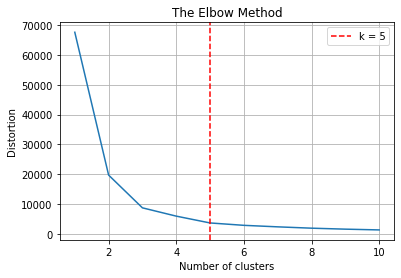

In [10]:
k = find_best_k(dtf[["Latitude","Longitude"]], max_k=10, plot=True)

In [11]:
model = cluster.KMeans(n_clusters=k, init='k-means++')

In [12]:
def fit_ml_cluster(X, model=None, k=None, lst_2Dplot=None, figsize=(10,5)):
    ## model
    if (model is None) and (k is None):
        model = cluster.AffinityPropagation()
        print("--- k not defined: using Affinity Propagation ---")
    elif (model is None) and (k is not None):
        model = cluster.KMeans(n_clusters=k, init='k-means++')
        print("---", "k="+str(k)+": using k-means ---")

    ## clustering
    dtf_X = X.copy()
    dtf_X["cluster"] = model.fit_predict(X)
    k = dtf_X["cluster"].nunique()
    print("--- found", k, "clusters ---")
    print(dtf_X.groupby("cluster")["cluster"].count().sort_values(ascending=False))

    ## find real centroids
    closest, distances = scipy.cluster.vq.vq(model.cluster_centers_, dtf_X.drop("cluster", axis=1).values)
    dtf_X["centroids"] = 0
    for i in closest:
        dtf_X["centroids"].iloc[i] = 1
    
    ## plot
    if (lst_2Dplot is not None) or (X.shape[1] == 2):
        lst_2Dplot = X.columns.tolist() if lst_2Dplot is None else lst_2Dplot
        th_centroids = model.cluster_centers_ if "KMeans" in str(model) else None
        utils_plot_cluster(dtf_X, x1=lst_2Dplot[0], x2=lst_2Dplot[1], th_centroids=th_centroids, figsize=figsize)

    return model, dtf_X



def utils_plot_cluster(dtf, x1, x2, th_centroids=None, figsize=(10,5)):
    ## plot points and real centroids
    fig, ax = plt.subplots(figsize=figsize)
    k = dtf["cluster"].nunique()
    sns.scatterplot(x=x1, y=x2, data=dtf, palette=sns.color_palette("bright",k),
                        hue='cluster', size="centroids", size_order=[1,0],
                        legend="brief", ax=ax).set_title('Clustering (k='+str(k)+')')

    ## plot theoretical centroids
    if th_centroids is not None:
        ax.scatter(th_centroids[:,dtf.columns.tolist().index(x1)], 
                   th_centroids[:,dtf.columns.tolist().index(x2)], 
                   s=50, c='black', marker="x")

    ## plot links from points to real centroids
    # if plot_links is True:
    #     centroids_idx = dtf[dtf["centroids"]==1].index
    #     colors = itertools.cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
    #     for k, col in zip(range(k), colors):
    #         class_members = dtf["cluster"].values == k
    #         cluster_center = dtf[[x1,x2]].values[centroids_idx[k]]
    #         plt.plot(dtf[[x1,x2]].values[class_members, 0], dtf[[x1,x2]].values[class_members, 1], col + '.')
    #         plt.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col, markeredgecolor='k', markersize=14)
    #         for x in dtf[[x1,x2]].values[class_members]:
    #             plt.plot([cluster_center[0], x[0]], 
    #                      [cluster_center[1], x[1]], 
    #                      col)

    ax.grid(True)
    plt.show()

--- found 5 clusters ---
cluster
0    2877
2    2062
3    1881
4    1871
1    1309
Name: cluster, dtype: int64


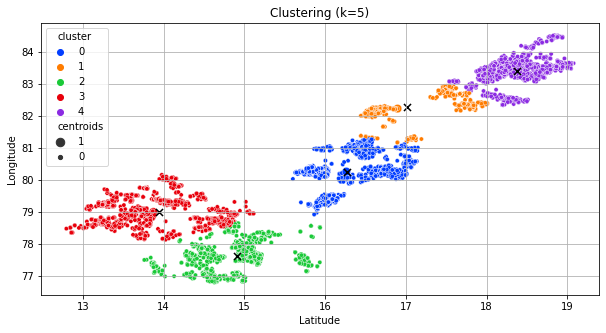

In [13]:
model, dtf_X = fit_ml_cluster(X=dtf[["Latitude","Longitude"]], model=model, figsize=(10,5))

In [14]:
dtf[["cluster","centroids"]] = dtf_X[["cluster","centroids"]]
dtf.sample(100)

,collection_sno,benid,stage,creationtime,status,app,observer_name,deviceid,Latitude,Longitude,State,cluster,centroids
5717,4951388,132541112NG759949,Not Started (NS),2/18/2017 13:15,-1,1.7,M Ramaiah,AE131101,16.787418,82.231893,Andhra Pradesh,1,0
7181,4967504,031503210NG5601235,Roof Level (RL),2/23/2017 11:01,-1,1.7,MGS BHASKARA RAJU,WI033201,16.598145,82.076097,Andhra Pradesh,1,0
5450,4948582,072172208NG770718,Basement Level (BL),2/15/2017 17:05,-1,1.7,V RAMBABU,AE072201,14.460718,77.700547,Andhra Pradesh,2,0
5849,4952738,061924709NG768614,Not Started (NS),2/18/2017 15:19,1,1.7,P PALLARAJU,AE064701,15.051562,77.865517,Andhra Pradesh,2,0
6267,4956781,082274410NG785043,Lintel Level (LL),2/18/2017 13:01,-1,1.7,M.Narasingarao,AE084401,17.943742,82.312713,Andhra Pradesh,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9045,4987048,011280407NG787614,Not Started (NS),3/3/2017 11:18,-1,1.7,D Rajamohan,AE010401,14.128240,78.391468,Andhra Pradesh,3,0
9775,4994363,082252308NG689036,Basement Level (BL),3/5/2017 17:05,-1,1.7,B SRINIVASA RAO,AE082301,18.460697,83.312503,Andhra Pradesh,4,0
5196,4945390,082313613NG719946,Below Basement Level (BBL),2/15/2017 17:14,-1,1.7,S.Satyanarayana,AE083601,14.558142,77.569525,Andhra Pradesh,2,0
3753,4927740,112443004NG664654,Below Basement Level (BBL),2/7/2017 11:09,-1,1.7,B OSURAPPA,AE113001,15.689428,80.270183,Andhra Pradesh,0,0


In [25]:
def plot_map(dtf, x, y, start, zoom=12, tiles="cartodbpositron", popup=None, size=None, color=None, legend=False, lst_colors=None, marker=None):
    data = dtf.copy()

    ## create columns for plotting
    if color is not None:
        lst_elements = sorted(list(dtf[color].unique()))
        lst_colors = ['#%06X' % np.random.randint(0, 0xFFFFFF) for i in range(len(lst_elements))] if lst_colors is None else lst_colors
        data["color"] = data[color].apply(lambda x: lst_colors[lst_elements.index(x)])

    if size is not None:
        scaler = preprocessing.MinMaxScaler(feature_range=(3,15))
        data["size"] = scaler.fit_transform(data[size].values.reshape(-1,1)).reshape(-1)

    ## map
    map_ = folium.Map(location=start, tiles=tiles, zoom_start=zoom)

    if (size is not None) and (color is None): 
        data.apply(lambda row: folium.CircleMarker(location=[row[x],row[y]], popup=row[popup],
                                                   color='#3186cc', fill=True, radius=row["size"]).add_to(map_), axis=1)
    elif (size is None) and (color is not None):
        data.apply(lambda row: folium.CircleMarker(location=[row[x],row[y]], popup=row[popup],
                                                   color=row["color"], fill=True, radius=5).add_to(map_), axis=1)
    elif (size is not None) and (color is not None):
        data.apply(lambda row: folium.CircleMarker(location=[row[x],row[y]], popup=row[popup],
                                                   color=row["color"], fill=True, radius=row["size"]).add_to(map_), axis=1)
    else:
        data.apply(lambda row: folium.CircleMarker(location=[row[x],row[y]], popup=row[popup],
                                                   color='#3186cc', fill=True, radius=5).add_to(map_), axis=1)
    
    ## legend
    if (color is not None) and (legend is True):
        legend_html = """<div style="position:fixed; bottom:10px; left:10px; border:2px solid black; z-index:9999; font-size:14px;">&nbsp;<b>"""+color+""":</b><br>"""
        for i in lst_elements:
            legend_html = legend_html+"""&nbsp;<i class="fa fa-circle fa-1x" style="color:"""+lst_colors[lst_elements.index(i)]+""""></i>&nbsp;"""+str(i)+"""<br>"""
        legend_html = legend_html+"""</div>"""
        map_.get_root().html.add_child(folium.Element(legend_html))
    
    ## add marker
    if marker is not None:
        lst_elements = sorted(list(dtf[marker].unique()))
        lst_colors = ["black","red","blue","green","pink","orange","gray"]  #7
        ### too many values, can't mark
        if len(lst_elements) > len(lst_colors):
            raise Exception("marker has uniques > "+str(len(lst_colors)))
        ### binary case (1/0): mark only 1s
        elif len(lst_elements) == 2:
            data[data[marker]==lst_elements[1]].apply(lambda row: folium.Marker(location=[row[x],row[y]], popup=row[marker], draggable=False, 
                                                                                icon=folium.Icon(color=lst_colors[0])).add_to(map_), axis=1) 
        ### normal case: mark all values
        else:
            for i in lst_elements:
                data[data[marker]==i].apply(lambda row: folium.Marker(location=[row[x],row[y]], popup=row[marker], draggable=False, 
                                                                      icon=folium.Icon(color=lst_colors[lst_elements.index(i)])).add_to(map_), axis=1)
    return map_

In [26]:
# Visualize Clusters on the map
map_ = plot_map(dtf, x="Latitude", y="Longitude", start=location, zoom=11, 
                tiles="cartodbpositron", popup="cluster", 
                size="status", color="stage", legend=True)
map_

In [27]:
model = minisom.MiniSom(x=4, y=4, input_len=2, neighborhood_function="gaussian", activation_distance="euclidean")

In [28]:
def fit_dl_cluster(X, model=None, epochs=100, lst_2Dplot=None, figsize=(10,5)):
    ## model
    model = minisom.MiniSom(x=int(np.sqrt(5*np.sqrt(X.shape[0]))), y=int(np.sqrt(5*np.sqrt(X.shape[0]))), input_len=X.shape[1]) if model is None else model
    scaler = preprocessing.StandardScaler()
    X_preprocessed = scaler.fit_transform(X.values)
    model.train_batch(X_preprocessed, num_iteration=epochs, verbose=False)
    
    ## clustering
    map_shape = (model.get_weights().shape[0], model.get_weights().shape[1])
    print("--- map shape:", map_shape, "---")
    dtf_X = X.copy()
    dtf_X["cluster"] = np.ravel_multi_index(np.array([model.winner(x) for x in X_preprocessed]).T, dims=map_shape)
    k = dtf_X["cluster"].nunique()
    print("--- found", k, "clusters ---")
    print(dtf_X.groupby("cluster")["cluster"].count().sort_values(ascending=False))
    
    ## find real centroids
    cluster_centers = np.array([vec for center in model.get_weights() for vec in center])
    closest, distances = scipy.cluster.vq.vq(cluster_centers, X_preprocessed)
    dtf_X["centroids"] = 0
    for i in closest:
        dtf_X["centroids"].iloc[i] = 1
    
    ## plot
    if (lst_2Dplot is not None) or (X.shape[1] == 2):
        lst_2Dplot = X.columns.tolist() if lst_2Dplot is None else lst_2Dplot
        utils_plot_cluster(dtf_X, x1=lst_2Dplot[0], x2=lst_2Dplot[1], th_centroids=scaler.inverse_transform(cluster_centers), figsize=figsize)

    return model, dtf_X

--- map shape: (4, 4) ---
--- found 16 clusters ---
cluster
15    6260
1     2017
11    1085
14     344
13      78
3       38
8       35
0       27
6       22
2       20
5       19
9       17
4       12
10      10
12      10
7        6
Name: cluster, dtype: int64


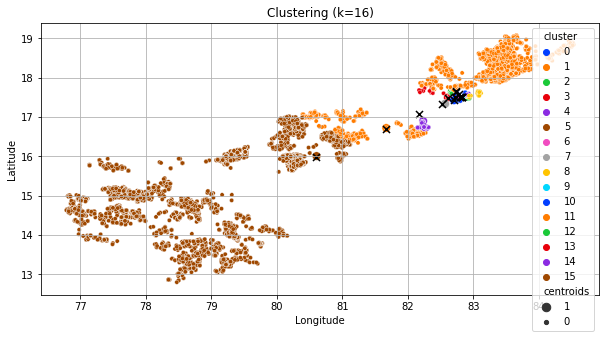

In [29]:
model, dtf_X = fit_dl_cluster(dtf[["Longitude","Latitude"]], model)

In [30]:
# Add cluster info into original dtf
dtf[["cluster","centroids"]] = dtf_X[["cluster","centroids"]]
dtf.sample(5)

,collection_sno,benid,stage,creationtime,status,app,observer_name,deviceid,Latitude,Longitude,State,cluster,centroids
5436,4948401,031514123NG623868,Basement Level (BL),2/17/2017 12:43,-1,1.7,G APPALANAIDU,AE034101,12.868198,78.346465,Andhra Pradesh,15,0
3463,4924434,132533914NG779739,Not Started (NS),2/9/2017 10:16,-1,1.7,A .V.S.N.Murthy,AE133901,16.581538,81.324403,Andhra Pradesh,11,0
1724,4904878,072095311NG738177,Not Started (NS),1/31/2017 16:08,-1,1.7,K ADIMURTHY,AE075301,17.050452,80.572768,Andhra Pradesh,11,0
9660,4993099,051753913NG754826,Below Basement Level (BBL),3/4/2017 13:04,-1,1.7,K K D T V PRASAD,AE053901,13.986118,79.290137,Andhra Pradesh,15,0
3280,4922210,132594314NG760764,Not Started (NS),2/9/2017 11:34,-1,1.7,R RAMA SUBBANNA,AE134301,15.988402,80.300958,Andhra Pradesh,15,0


In [32]:
# Visualize Clusters on the map
map_ = plot_map(dtf, x="Latitude", y="Longitude", start=location, zoom=11, 
                tiles="cartodbpositron", popup="cluster", 
                size="status", color="stage", legend=True)
map_

In [33]:
model = cluster.AffinityPropagation()

--- found 1 clusters ---
cluster
-1    10000
Name: cluster, dtype: int64


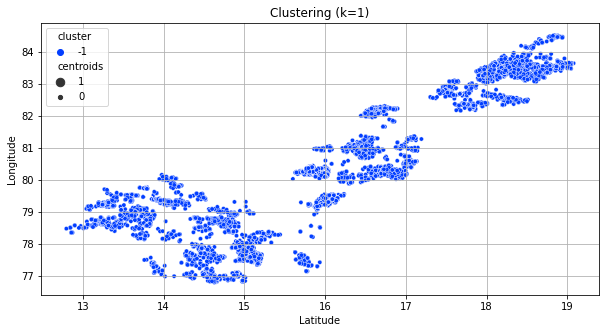

In [34]:
model, dtf_X = fit_ml_cluster(X=dtf[["Latitude","Longitude"]], model=model, figsize=(10,5))